In [1]:
import os
import cv2
import numpy as np
import pandas as pd
import GenderModel
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Input
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras import backend as K
from sklearn.model_selection import train_test_split
from tensorflow.keras import layers
from tensorflow.keras.layers import Concatenate
import random
from sklearn.utils.class_weight import compute_class_weight
import matplotlib.pyplot as plt

target_shape = (224,224)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


## Preparing training data

In [2]:
# Function to read and preprocess the image
def read_and_preprocess_image(filepath):
    img = cv2.imread(filepath)
    img = cv2.resize(img, (224, 224))  # Resize to match VGG Face input shape
    img = img / 255.0  # Normalize pixel values to [0, 1]
    img = img.astype(np.float32)
    return img


In [2]:

# Define the paths to the anchor, positive, and negative folders
anchor_folder = 'train_val_data/tarining_data/anchor'
positive_folder = 'train_val_data/tarining_data/positive'
negative_folder = 'train_val_data/tarining_data/negative'

# Get the filenames in each folder and sort them based on their integer values
len_images = len(os.listdir(anchor_folder))
images_sorted = []
for i in range(len_images):
    images_sorted.append(str(i)+'.jpg')
    
anchor_filenames = positive_filenames = negative_filenames = images_sorted

# Create triplets (anchor, positive, negative)
triplets = []
for i in range(len(anchor_filenames)):
    anchor_filepath = os.path.join(anchor_folder, anchor_filenames[i])
    positive_filepath = os.path.join(positive_folder, positive_filenames[i])
    negative_filepath = os.path.join(negative_folder, negative_filenames[i])
    
    anchor_image = read_and_preprocess_image(anchor_filepath)
    positive_image = read_and_preprocess_image(positive_filepath)
    negative_image = read_and_preprocess_image(negative_filepath)
    
    triplets.append((anchor_image, positive_image, negative_image))

# Convert triplets to numpy arrays
anchor_images = np.array([t[0] for t in triplets])
positive_images = np.array([t[1] for t in triplets])
negative_images = np.array([t[2] for t in triplets])


df_gender_train = pd.read_csv('train_val_data/train_gender.csv')
df_gender_train['gender'] = df_gender_train['gender'].replace({'M': 1, 'F': 0})
x_train = [anchor_images,positive_images,negative_images]
y_gender_train_old = np.array(list(df_gender_train['gender']))


n = y_gender_train_old.shape[0]
y_gender_train = np.zeros((n, 2), dtype=int)
# Use boolean indexing to set (i, 0) or (i, 1) index to 1 based on the original array
y_gender_train[np.arange(n), y_gender_train_old] = 1
# y_gender_train

## Select all female images and twice of that male images (Training Data)

In [3]:
# Define the paths to the anchor, positive, and negative folders
anchor_folder = 'train_val_data/tarining_data/anchor'
positive_folder = 'train_val_data/tarining_data/positive'
negative_folder = 'train_val_data/tarining_data/negative'

# Get the filenames in each folder and sort them based on their integer values
len_images = len(os.listdir(anchor_folder))
images_sorted = []
for i in range(len_images):
    images_sorted.append(str(i)+'.jpg')
    
anchor_filenames = positive_filenames = negative_filenames = images_sorted

# Load the label of each data
df_gender_train = pd.read_csv('train_val_data/train_gender.csv')
df_gender_train['gender'] = df_gender_train['gender'].replace({'M': 1, 'F': 0})
y_gender_train_old = np.array(list(df_gender_train['gender']))

## Get female indices
female_indices = y_gender_train_old == 0
male_indices_all = y_gender_train_old == 1
num_female = len(df_gender_train[df_gender_train['gender'] == 0])
num_male = 2*num_female

print(num_male,num_female)

female_indices = list(np.where(female_indices)[0])
male_indices_all = list(np.where(male_indices_all)[0])

male_indices = random.sample(male_indices_all,num_male)

# Create triplets (anchor, positive, negative)
triplets = []
## Loading female images
for i in female_indices:
    anchor_filepath = anchor_folder+'/'+str(i)+'.jpg'
    positive_filepath = positive_folder+'/'+str(i)+'.jpg'
    negative_filepath = negative_folder+'/'+str(i)+'.jpg'
    
    anchor_image = read_and_preprocess_image(anchor_filepath)
    positive_image = read_and_preprocess_image(positive_filepath)
    negative_image = read_and_preprocess_image(negative_filepath)
    gender_label = y_gender_train_old[i]
    
    triplets.append((anchor_image, positive_image, negative_image,gender_label))

## Loading male images
for i in male_indices:
    anchor_filepath = anchor_folder+'/'+str(i)+'.jpg'
    positive_filepath = positive_folder+'/'+str(i)+'.jpg'
    negative_filepath = negative_folder+'/'+str(i)+'.jpg'
    
    anchor_image = read_and_preprocess_image(anchor_filepath)
    positive_image = read_and_preprocess_image(positive_filepath)
    negative_image = read_and_preprocess_image(negative_filepath)
    gender_label = y_gender_train_old[i]
    
    triplets.append((anchor_image, positive_image, negative_image,gender_label))

## randomly shuffle dataset
random.shuffle(triplets)
# Convert triplets to numpy arrays
anchor_images = np.array([t[0] for t in triplets])
positive_images = np.array([t[1] for t in triplets])
negative_images = np.array([t[2] for t in triplets])
y_gender_train_old = np.array([t[3] for t in triplets])

n = y_gender_train_old.shape[0]
y_gender_train = np.zeros((n, 2), dtype=int)
# Use boolean indexing to set (i, 0) or (i, 1) index to 1 based on the original array
y_gender_train[np.arange(n), y_gender_train_old] = 1

x_train = [anchor_images,positive_images,negative_images]

1096 548


In [4]:
def plot_image(triplet):
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))

    # Plot the first image in the first subplot
    axs[0].imshow(triplet[0])
    axs[0].set_title('Image 1')

    # Plot the second image in the second subplot
    axs[1].imshow(triplet[1])
    axs[1].set_title('Image 2')

    # Plot the third image in the third subplot
    axs[2].imshow(triplet[2])
    axs[2].set_title('Image 3')
    
    plt.show()

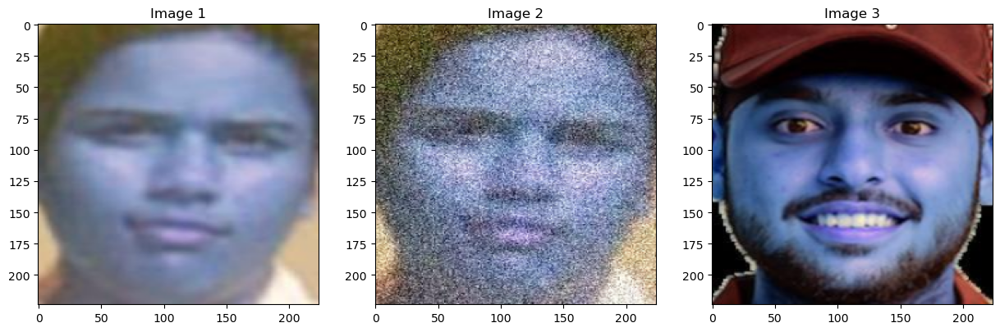

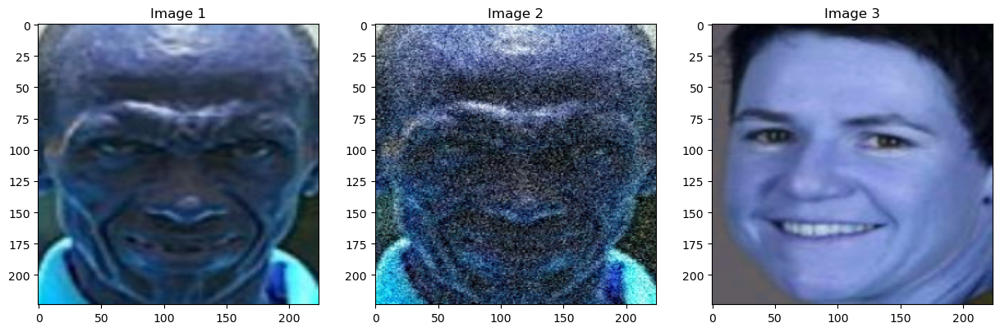

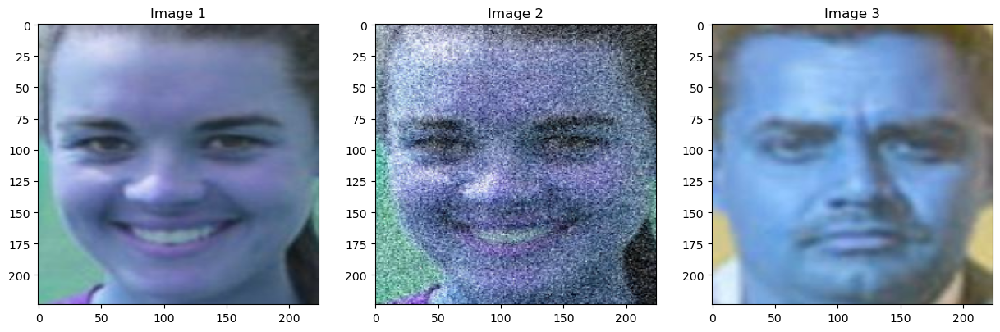

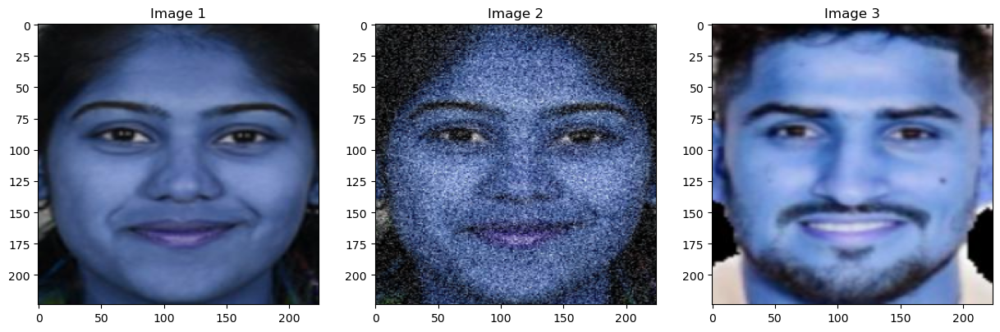

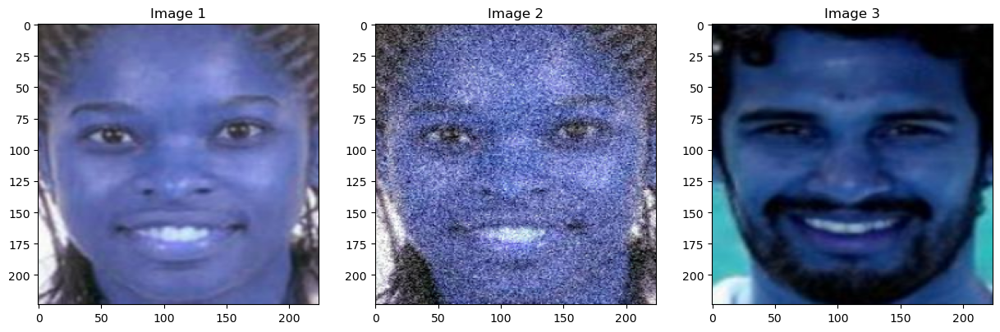

...

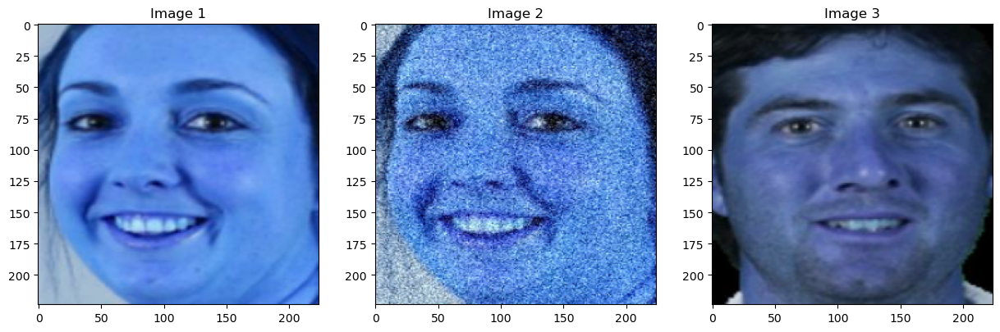

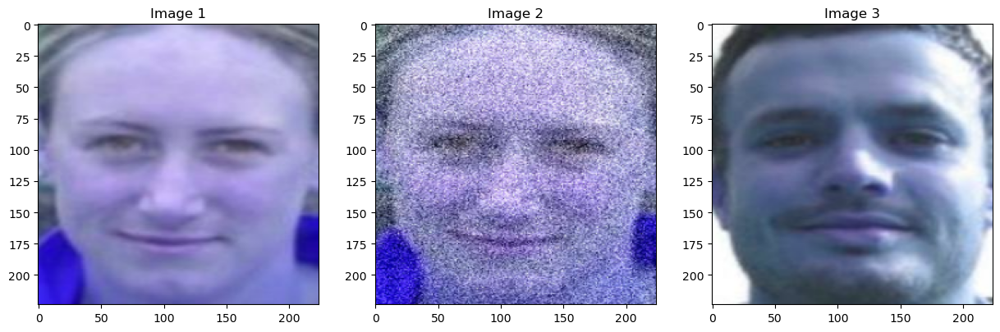

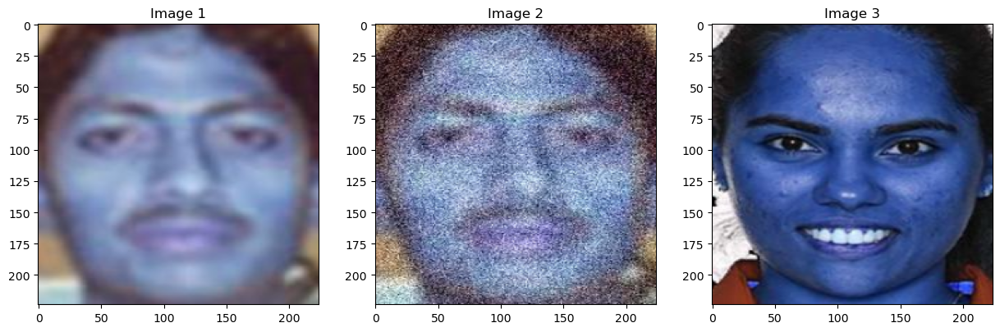

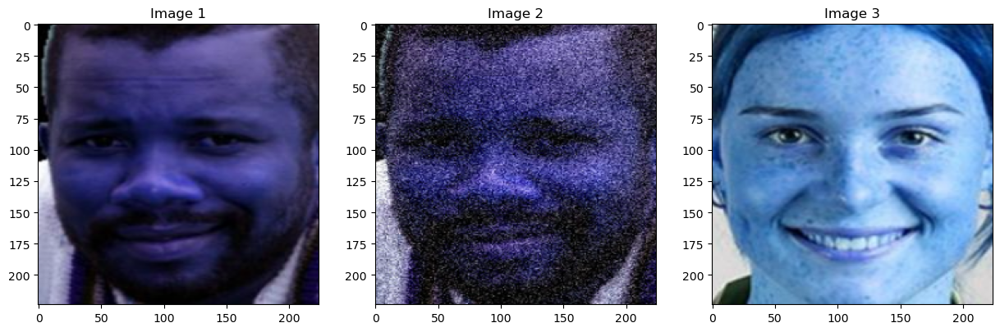

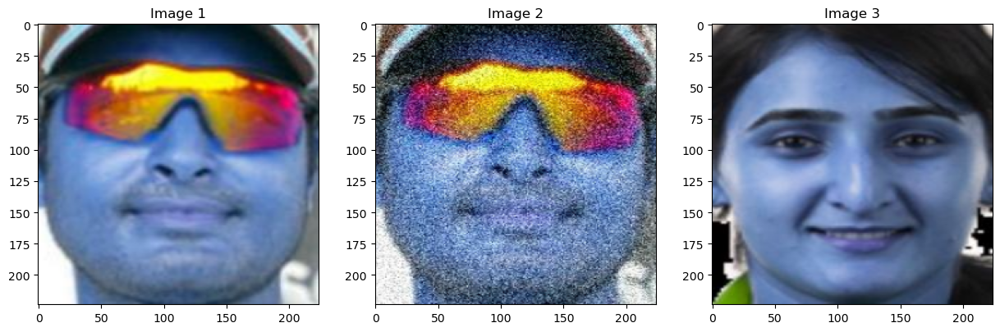

In [7]:
for i in range(20):
    plot_image([x_train[0][i],x_train[1][i],x_train[2][i]])

## Preparing validation data

In [3]:
# Define the paths to the anchor, positive, and negative folders
anchor_folder_val = 'train_val_data/validation_data/anchor'
positive_folder_val = 'train_val_data/validation_data/positive'
negative_folder_val = 'train_val_data/validation_data/negative'

# Get the filenames in each folder and sort them based on their integer values
len_images = len(os.listdir(anchor_folder_val))
images_sorted = []
for i in range(len_images):
    images_sorted.append(str(i)+'.jpg')
    
anchor_filenames_val = positive_filenames_val = negative_filenames_val = images_sorted

# Create triplets (anchor, positive, negative)
triplets_val = []
for i in range(len(anchor_filenames_val)):
    anchor_filepath = os.path.join(anchor_folder_val, anchor_filenames_val[i])
    positive_filepath = os.path.join(positive_folder_val, positive_filenames_val[i])
    negative_filepath = os.path.join(negative_folder_val, negative_filenames_val[i])
    
    anchor_image = read_and_preprocess_image(anchor_filepath)
    positive_image = read_and_preprocess_image(positive_filepath)
    negative_image = read_and_preprocess_image(negative_filepath)
    
    triplets_val.append((anchor_image, positive_image, negative_image))

# Convert triplets to numpy arrays
anchor_images_val = np.array([t[0] for t in triplets_val])
positive_images_val = np.array([t[1] for t in triplets_val])
negative_images_val = np.array([t[2] for t in triplets_val])

df_gender_train = pd.read_csv('train_val_data/val_gender.csv')
df_gender_train['gender'] = df_gender_train['gender'].replace({'M': 1, 'F': 0})
x_val = [anchor_images_val,positive_images_val,negative_images_val]
y_gender_train_old_val = np.array(list(df_gender_train['gender']))

n = y_gender_train_old_val.shape[0]
y_gender_val = np.zeros((n, 2), dtype=int)
# Use boolean indexing to set (i, 0) or (i, 1) index to 1 based on the original array
y_gender_val[np.arange(n), y_gender_train_old_val] = 1
# y_gender_train

## Select all female images and twice of that male images (Validtaion Data)

In [15]:
# Define the paths to the anchor, positive, and negative folders
anchor_folder_val = 'train_val_data/validation_data/anchor'
positive_folder_val = 'train_val_data/validation_data/positive'
negative_folder_val = 'train_val_data/validation_data/negative'

# Get the filenames in each folder and sort them based on their integer values
len_images = len(os.listdir(anchor_folder_val))
images_sorted = []
for i in range(len_images):
    images_sorted.append(str(i)+'.jpg')
    
anchor_filenames_val = positive_filenames_val = negative_filenames_val = images_sorted

# Load the label of each data
df_gender_train = pd.read_csv('train_val_data/val_gender.csv')
df_gender_train['gender'] = df_gender_train['gender'].replace({'M': 1, 'F': 0})
y_gender_train_old_val = np.array(list(df_gender_train['gender']))

## Get female indices
female_indices = y_gender_train_old_val == 0
male_indices_all = y_gender_train_old_val == 1
num_female = len(df_gender_train[df_gender_train['gender'] == 0])
num_male = 2*num_female

female_indices = list(np.where(female_indices)[0])
male_indices_all = list(np.where(male_indices_all)[0])

male_indices = random.sample(male_indices_all,num_male)

# Create triplets (anchor, positive, negative)
triplets_val = []
## Loading female images
for i in female_indices:
    anchor_filepath = anchor_folder_val+'/'+str(i)+'.jpg'
    positive_filepath = positive_folder_val+'/'+str(i)+'.jpg'
    negative_filepath = negative_folder_val+'/'+str(i)+'.jpg'
    
    anchor_image = read_and_preprocess_image(anchor_filepath)
    positive_image = read_and_preprocess_image(positive_filepath)
    negative_image = read_and_preprocess_image(negative_filepath)
    gender_label = y_gender_train_old_val[i]
    
    triplets_val.append((anchor_image, positive_image, negative_image,gender_label))

## Loading male images
for i in male_indices:
    anchor_filepath = anchor_folder_val+'/'+str(i)+'.jpg'
    positive_filepath = positive_folder_val+'/'+str(i)+'.jpg'
    negative_filepath = negative_folder_val+'/'+str(i)+'.jpg'
    
    anchor_image = read_and_preprocess_image(anchor_filepath)
    positive_image = read_and_preprocess_image(positive_filepath)
    negative_image = read_and_preprocess_image(negative_filepath)
    gender_label = y_gender_train_old_val[i]
    
    triplets_val.append((anchor_image, positive_image, negative_image,gender_label))

## randomly shuffle dataset
random.shuffle(triplets_val)
# Convert triplets to numpy arrays
anchor_images_val = np.array([t[0] for t in triplets_val])
positive_images_val = np.array([t[1] for t in triplets_val])
negative_images_val = np.array([t[2] for t in triplets_val])
y_gender_val_old = np.array([t[3] for t in triplets_val])

n = y_gender_val_old.shape[0]
y_gender_val = np.zeros((n, 2), dtype=int)
# Use boolean indexing to set (i, 0) or (i, 1) index to 1 based on the original array
y_gender_val[np.arange(n), y_gender_val_old] = 1

x_val = [anchor_images_val,positive_images_val,negative_images_val]

In [16]:
y_gender_val

array([[0, 1],
       [0, 1],
       [1, 0],
       ...,
       [0, 1],
       [0, 1],
       [0, 1]])

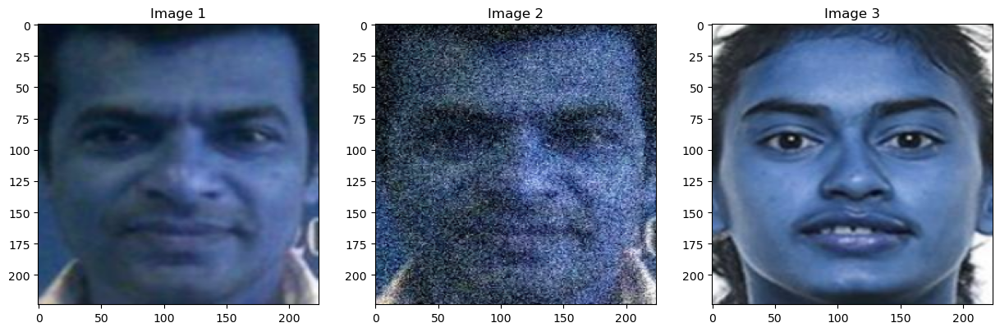

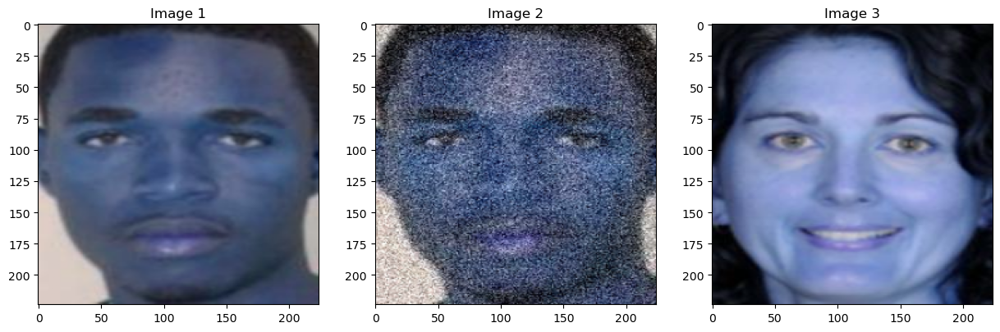

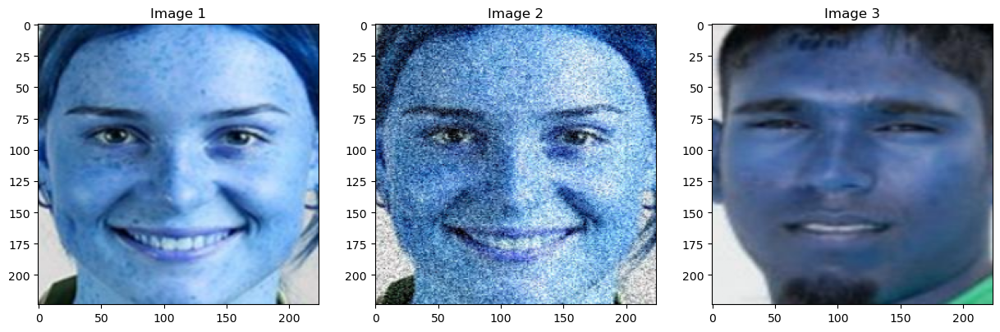

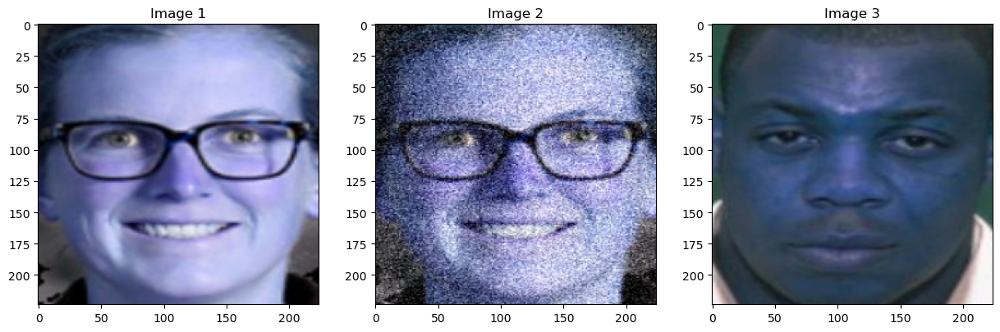

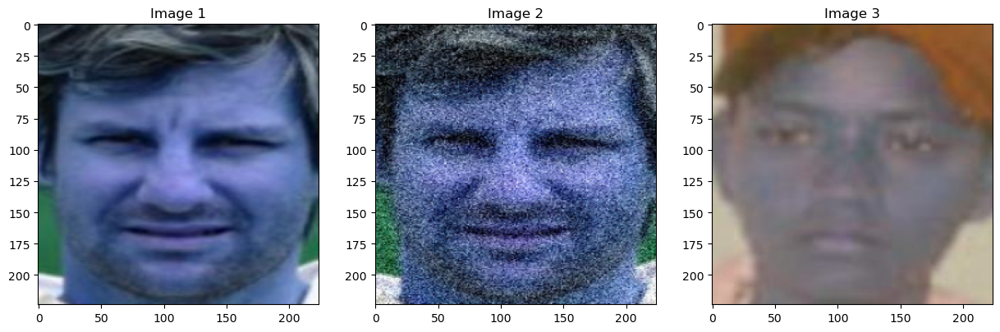

...

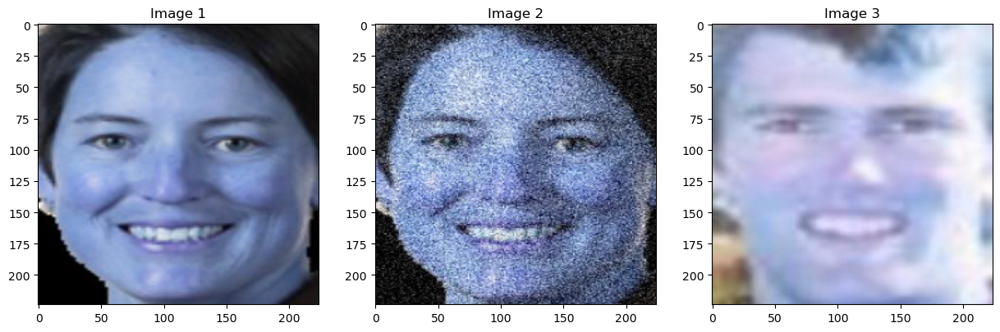

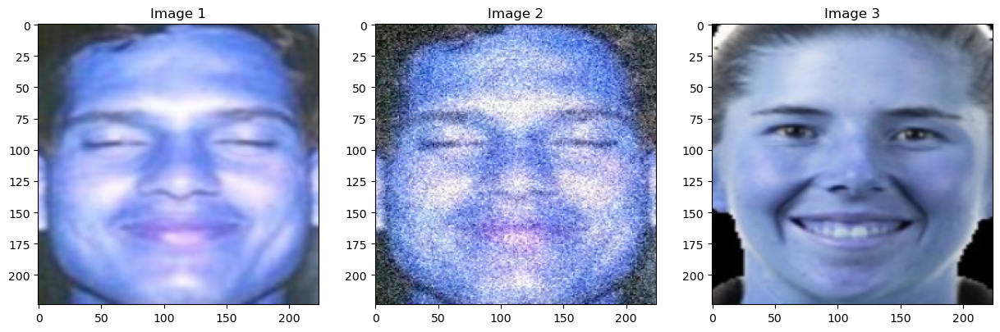

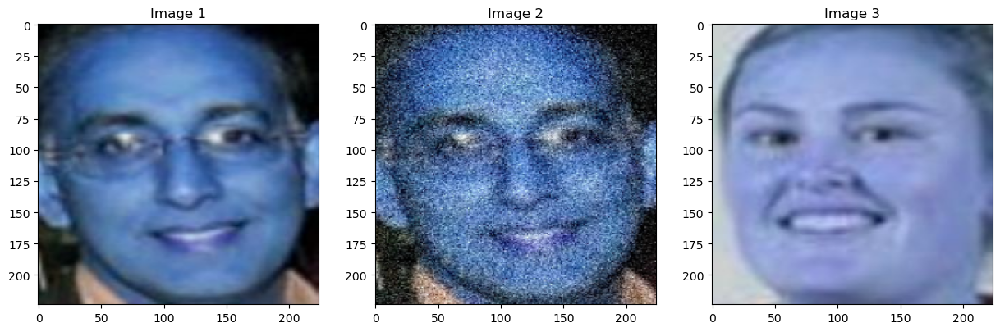

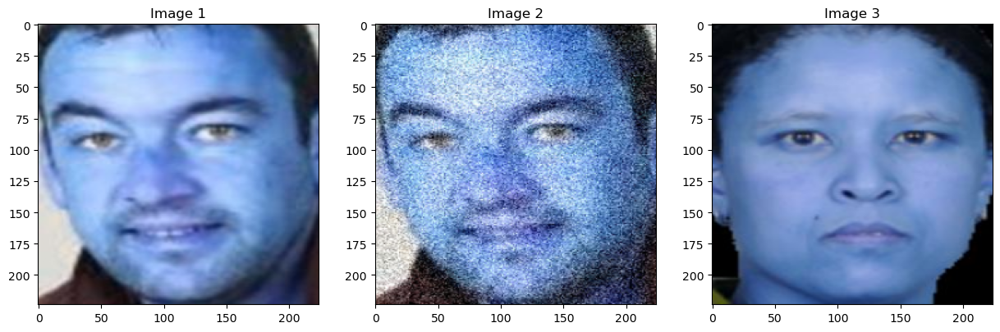

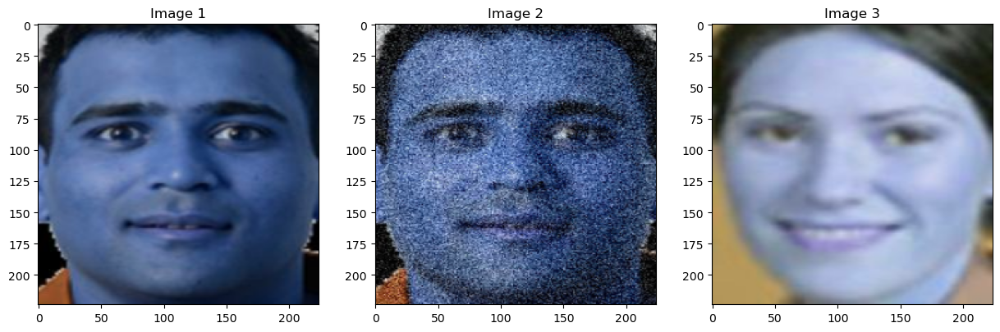

In [17]:
for i in range(20):
    plot_image([x_val[0][i],x_val[1][i],x_val[2][i]])

In [11]:
## Load the model
loaded_model = GenderModel.loadModel()
for layer in loaded_model.layers:
        layer.trainable = True  # Set all layers to trainable

# Define separate input layers for anchor, positive, and negative images
input_anchor = Input(shape=(224, 224, 3), name='input_anchor')
input_positive = Input(shape=(224, 224, 3), name='input_positive')
input_negative = Input(shape=(224, 224, 3), name='input_negative')

# Get the desired layer 'conv2d_12' from the loaded model
desired_layer = loaded_model.get_layer('conv2d_12')

# Create a new model that goes from the input layer to the desired layer 'conv2d_12'
embedding_model = Model(inputs=loaded_model.input, outputs=desired_layer.output)
# Use the embedding_model to obtain the embeddings from 'conv2d_12' for anchor, positive, and negative images
anchor_embeddings = embedding_model(input_anchor)
positive_embeddings = embedding_model(input_positive)
negative_embeddings = embedding_model(input_negative)

# Concatenate the embeddings from anchor, positive, and negative images
combined_embeddings = Concatenate(axis=-1)([anchor_embeddings, positive_embeddings, negative_embeddings])

# Create the combined model with the three input layers and the two outputs
model = Model(inputs=[input_anchor, input_positive, input_negative], outputs=[combined_embeddings,loaded_model(input_anchor)])

ValueError: No such layer: conv2d_12. Existing layers are: ['zero_padding2d_13_input', 'zero_padding2d_13', 'conv2d_16', 'zero_padding2d_14', 'conv2d_17', 'max_pooling2d_5', 'zero_padding2d_15', 'conv2d_18', 'zero_padding2d_16', 'conv2d_19', 'max_pooling2d_6', 'zero_padding2d_17', 'conv2d_20', 'zero_padding2d_18', 'conv2d_21', 'zero_padding2d_19', 'conv2d_22', 'max_pooling2d_7', 'zero_padding2d_20', 'conv2d_23', 'zero_padding2d_21', 'conv2d_24', 'zero_padding2d_22', 'conv2d_25', 'max_pooling2d_8', 'zero_padding2d_23', 'conv2d_26', 'zero_padding2d_24', 'conv2d_27', 'zero_padding2d_25', 'conv2d_28', 'max_pooling2d_9', 'conv2d_29', 'dropout_2', 'conv2d_30', 'dropout_3', 'predictions', 'flatten_3', 'activation_3'].

In [15]:
# Define the triplet loss function
def triplet_loss(y_true, y_pred, alpha=0.2):
    anchor, positive, negative = y_pred[:, 0], y_pred[:, 1], y_pred[:, 2]
    pos_dist = K.sum(K.square(anchor - positive), axis=-1)
    neg_dist = K.sum(K.square(anchor - negative), axis=-1)
    basic_loss = pos_dist - neg_dist + alpha
    loss = K.maximum(basic_loss, 0.0)
    return loss

losses = {
    'concatenate': triplet_loss,  # Output layer name for embeddings
    'model': BinaryCrossentropy()  # Output layer name for gender prediction
}
# Compile the model with triplet loss and binary cross-entropy loss for gender prediction
model.compile(
        optimizer=Adam(learning_rate=0.00001),
        loss=losses,
        loss_weights={'concatenate': 1.0, 'model': 1.0},  # You can adjust the loss weights as needed
        metrics={'model': 'accuracy'}
    )

In [30]:
# # Custom training loop for triplet loss and gender prediction
def custom_generator(x_data, y_gender_data, anchor_indices, positive_indices, negative_indices, batch_size=32):
    while True:
        num_samples = len(anchor_indices)
        indices = list(range(num_samples))
        random.shuffle(indices)
        start_index = 0
        while start_index < num_samples:
            batch_indices = indices[start_index : start_index + batch_size]
            # Extract the anchor, positive, and negative examples from the corresponding lists
            anchor_batch = x_data[0][anchor_indices[batch_indices]]
            positive_batch = x_data[1][anchor_indices[batch_indices]]
            negative_batch = x_data[2][anchor_indices[batch_indices]]

            # Extract the gender labels for the anchor examples
            gender_label_batch = y_gender_data[batch_indices]
            yield [anchor_batch, positive_batch, negative_batch], [anchor_batch, gender_label_batch]

            start_index += batch_size

In [31]:
# Create indices for the anchor, positive, and negative images
num_samples = len(anchor_images)
indices = np.arange(num_samples)
anchor_indices = positive_indices = negative_indices = indices

### For validation set #######  
anchor_indices_val = positive_indices_val = negative_indices_val = np.arange(len(y_gender_val))

# Train the model using the custom generator
batch_size = 4
num_steps_per_epoch = len(anchor_indices) // batch_size
epochs = 10

val_steps_per_epoch = len(anchor_indices_val) // batch_size

class_weight = {0:0.87,1:0.13}

model.fit(custom_generator(x_train, y_gender_train, anchor_indices, positive_indices, negative_indices, batch_size),
          steps_per_epoch=num_steps_per_epoch,
          epochs=epochs,
          validation_data = custom_generator(x_val, y_gender_val, anchor_indices_val, positive_indices_val, negative_indices_val, batch_size),
          validation_steps=val_steps_per_epoch
)

model.save('vgg_face_triplet_loss_full_'+str(epochs)+'_epochs.h5')
# model.get_layer("model").save('vgg_face_triplet_loss_'+str(epochs)+'_epochs.h5')

Epoch 1/10
  9/457 [..............................] - ETA: 1:08:33 - loss: 0.8655 - concatenate_loss: 0.1861 - model_loss: 0.6794 - model_accuracy: 0.9722


KeyboardInterrupt



In [5]:
import matplotlib.pyplot as plt

In [32]:
model.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_anchor (InputLayer)      [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 input_positive (InputLayer)    [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 input_negative (InputLayer)    [(None, 224, 224, 3  0           []                               
                                )]                                                          

In [33]:
model.get_layer("model").get_weights()[0]

array([[[[ 0.01597719, -0.05396421, -0.08509633, ..., -0.03404398,
           0.07725276, -0.06311191],
         [ 0.0513228 ,  0.09745648, -0.093705  , ..., -0.0624837 ,
           0.01702293,  0.02708353],
         [ 0.02980418,  0.06226895,  0.0804251 , ...,  0.02043465,
          -0.09652288, -0.01698566]],

        [[ 0.0335529 , -0.03212887,  0.03790824, ..., -0.05623478,
          -0.06833976,  0.02390068],
         [-0.01327108, -0.02807412,  0.08396234, ..., -0.03575925,
          -0.03835585, -0.09221031],
         [-0.06363515,  0.00227716, -0.03408463, ...,  0.09338541,
           0.00964905,  0.06226106]],

        [[ 0.06039804,  0.06213772, -0.0394213 , ...,  0.03222832,
          -0.08290788, -0.00467655],
         [ 0.09365992, -0.04366995, -0.05827492, ...,  0.03018595,
           0.0329946 ,  0.08938377],
         [-0.00638649,  0.03354117,  0.08582961, ..., -0.08969427,
           0.05739717, -0.05270842]]],


       [[[ 0.04010135, -0.08460203,  0.01943408, ...,  0

In [23]:
model.get_layer("model").get_weights()[0]

array([[[[ 0.01592739, -0.05406768, -0.08509403, ..., -0.03414374,
           0.0771493 , -0.06307034],
         [ 0.05127464,  0.09735315, -0.09370331, ..., -0.06258382,
           0.01691955,  0.02712579],
         [ 0.0297599 ,  0.06216606,  0.08042899, ...,  0.02033433,
          -0.09662571, -0.01694261]],

        [[ 0.03351702, -0.03223232,  0.03791445, ..., -0.05633464,
          -0.06844311,  0.02394743],
         [-0.01330758, -0.02817746,  0.08396472, ..., -0.03585946,
          -0.03845917, -0.09216554],
         [-0.06367068,  0.00217429, -0.03407936, ...,  0.09328501,
           0.00954629,  0.06230342]],

        [[ 0.06034927,  0.06203428, -0.03941701, ...,  0.03212875,
          -0.08301124, -0.00463789],
         [ 0.09361178, -0.04377326, -0.05827489, ...,  0.03008592,
           0.03289129,  0.08941938],
         [-0.00642976,  0.03343831,  0.08583422, ..., -0.08979452,
           0.05729441, -0.05267514]]],


       [[[ 0.04004979, -0.08470547,  0.01943742, ...,  0

In [8]:
import numpy as np

In [10]:
a = np.array([1,0,1,0,0,0,1,0,0,1,0,1,0,1])


In [11]:
unique, counts = np.unique(a, return_counts=True)

In [13]:
counts

array([8, 6], dtype=int64)